# FastAI with frontal images

In [18]:
import os
import random
from pathlib import Path

import fastai
import matplotlib.pyplot as plt
import torch
import torchvision
from fastai.callbacks.hooks import hook_output
from fastai.vision import *
from fastai.widgets import *
from flashtorch.saliency import Backprop
from flashtorch.utils import (apply_transforms, denormalize,
                              format_for_plotting, load_image,
                              standardize_and_clip)
from scipy.spatial.distance import cosine
from sklearn.neighbors import KNeighborsClassifier
from torchvision import transforms


In [3]:
fastai.device = torch.device('cuda')

## Get the data and build the model

In [4]:
data = ImageDataBunch.from_folder('/home/mauto/data/LincParse/cv_dataset_frontal_same', ds_tfms=get_transforms(), size=224, num_workers=8).normalize(imagenet_stats)

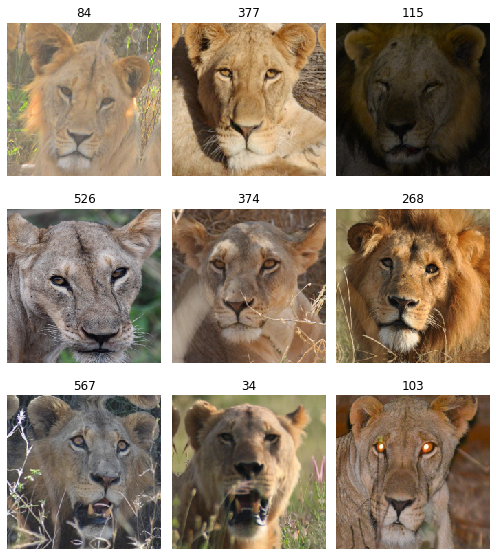

In [4]:
data.show_batch(rows=3, figsize=(7,8))

In [5]:
data.c, len(data.train_ds), len(data.valid_ds)

(136, 2509, 521)

In [5]:
learn = cnn_learner(data, models.resnet50, metrics=[accuracy, top_k_accuracy])

## Train last layer

In [7]:
learn.fit_one_cycle(10)

epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,5.277438,2.537233,0.437620,0.650672,00:17
1,3.322368,1.343639,0.677543,0.846449,00:16
2,2.208684,0.878500,0.775432,0.919386,00:15
3,1.525775,0.730235,0.825336,0.936660,00:16
4,1.079154,0.596307,0.836852,0.955854,00:15
5,0.768948,0.517143,0.854127,0.961612,00:17
6,0.542403,0.480674,0.875240,0.955854,00:15
7,0.407838,0.451302,0.880998,0.965451,00:16
8,0.324434,0.435983,0.882917,0.965451,00:16
9,0.278620,0.432897,0.888676,0.967370,00:16


In [8]:
learn.save('stage-1')

In [ ]:
learn.load('stage-1')

## Train all model

In [9]:
learn.unfreeze()

In [10]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


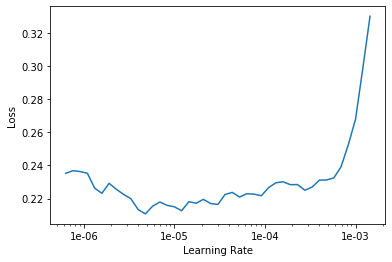

In [11]:
learn.recorder.plot()

In [12]:
learn.fit_one_cycle(10)

epoch,train_loss,valid_loss,accuracy,top_k_accuracy,time
0,0.245051,0.424316,0.894434,0.963532,00:18
1,0.388729,0.937983,0.769674,0.923225,00:18
2,0.812172,1.093657,0.735125,0.928983,00:18
3,0.766802,0.580865,0.848369,0.965451,00:18
4,0.560447,0.443686,0.875240,0.978887,00:18
5,0.348348,0.289611,0.927063,0.975048,00:18
6,0.206566,0.230301,0.944338,0.984645,00:19
7,0.124160,0.223814,0.946257,0.984645,00:18
8,0.074064,0.221399,0.944338,0.982726,00:18
9,0.056578,0.217889,0.946257,0.982726,00:19


## Analyze results

In [13]:
interp = ClassificationInterpretation.from_learner(learn)

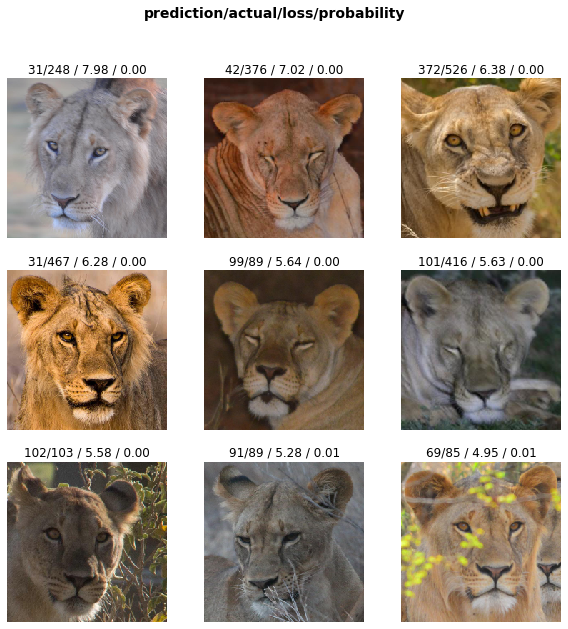

In [14]:
interp.plot_top_losses(9, figsize=(10,10))

In [15]:
interp.most_confused(min_val=2)

[('351', '352', 2)]

In [16]:
learn.save('stage-2')

In [6]:
learn.load('stage-2')

Learner(data=ImageDataBunch;

Train: LabelList (2509 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
401,401,401,401,401
Path: /home/mauto/data/LincParse/cv_dataset_frontal_same;

Valid: LabelList (521 items)
x: ImageList
Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224),Image (3, 224, 224)
y: CategoryList
401,401,90,90,90
Path: /home/mauto/data/LincParse/cv_dataset_frontal_same;

Test: None, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-0

## Save model

In [7]:
learn.export()

In [ ]:
learner = load_learner('/home/mauto/data/LincParse/cv_dataset_frontal_same')

## Saliency Maps

In [8]:
backprop = Backprop(learn.model)

In [9]:
sample = learn.data.train_ds[90]

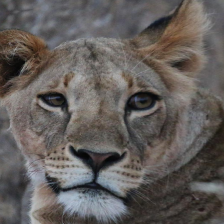

In [42]:
sample[0]

In [43]:
pred = learn.predict(sample[0])

In [44]:
input_ = sample[0].data.unsqueeze_(0)
input_.requires_grad = True

In [45]:
gradients = backprop.calculate_gradients(input_.cuda(), pred[1].cuda(), use_gpu=True)

/home/mauto/.local/share/virtualenvs/linc-venv/lib/python3.6/site-packages/flashtorch/saliency/backprop.py:111: UserWarning: The predicted class index 119 does notequal the target class index 127. Calculatingthe gradient w.r.t. the predicted class.
  'the gradient w.r.t. the predicted class.'


In [46]:
max_gradients = backprop.calculate_gradients(input_.cuda(), pred[1].cuda(), take_max=True, use_gpu=True)

In [26]:
def visualize(input_, gradients, max_gradients):
    subplots = [
    # (title, [(image1, cmap, alpha), (image2, cmap, alpha)])
    ('Input image', [(format_for_plotting(denormalize(input_)), None, None)]),
    ('Gradients across RGB channels',[(format_for_plotting(standardize_and_clip(gradients)), None, None)]),
    ('Max gradients', [(format_for_plotting(standardize_and_clip(max_gradients)), 'viridis', None)]),
    ('Overlay', [(format_for_plotting(denormalize(input_)), None, None), (format_for_plotting(standardize_and_clip(max_gradients)), 'viridis', .5)])
    ]

    fig = plt.figure(figsize=(16, 4))

    for i, (title, images) in enumerate(subplots):
        ax = fig.add_subplot(1, len(subplots), i + 1)
        ax.set_axis_off()
        ax.set_title(title)

        for image, cmap, alpha in images:
            ax.imshow(image, cmap=cmap, alpha=alpha)

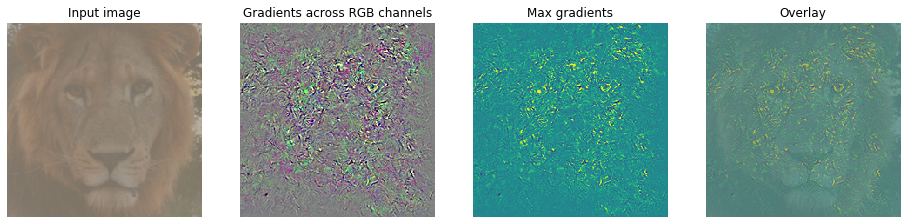

In [27]:
visualize(input_ ,gradients, max_gradients)

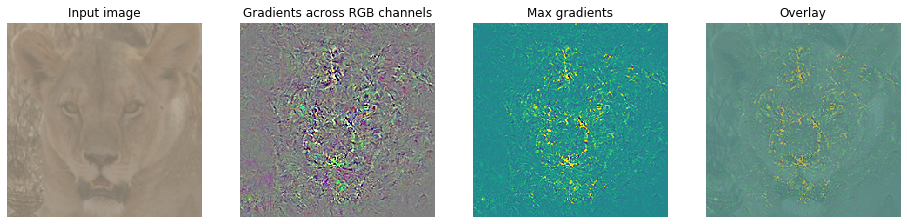

In [34]:
visualize(input_ ,gradients, max_gradients)

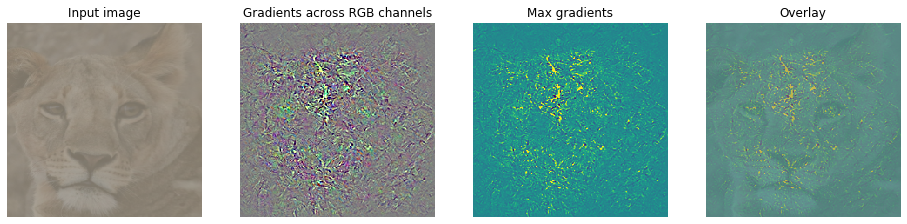

In [47]:
visualize(input_ ,gradients, max_gradients)

## Plotting matching scores

In [10]:
def imshow(img,text=None,should_save=False):
    npimg = img.numpy()
    plt.axis("off")
    if text:
        plt.text(75, 8, text, style='italic',fontweight='bold',
            bbox={'facecolor':'white', 'alpha':0.8, 'pad':10})
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()  

In [13]:
def print_pair(pair,tfms,learn,cos,emb_layer):
    (img1,img2) = pair
    img1 = open_image(img1)
    img2 = open_image(img2)
    img1 = img1.apply_tfms(tfms[0], size=224)
    img2 = img2.apply_tfms(tfms[0], size=224)
    concatenated = torch.cat((img1.data.unsqueeze(0),img2.data.unsqueeze(0)),0)
    hook = hook_output(emb_layer)
    pred1 = learn.predict(img1)
    emb1 = hook.stored
    pred2 = learn.predict(img2)
    emb2 = hook.stored
    hook.remove()
    score_l2 = torch.dist(emb1[0],emb2[0])
    score_cos = cos(emb1,emb2)
    imshow(torchvision.utils.make_grid(concatenated),"Score norm: {:.2f}, Score cos: {:.2f}".format(score_l2, score_cos[0]))

SAME


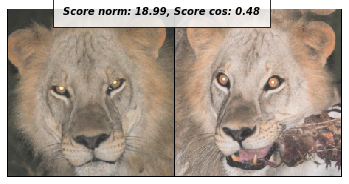

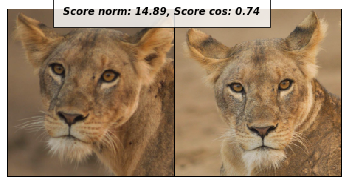

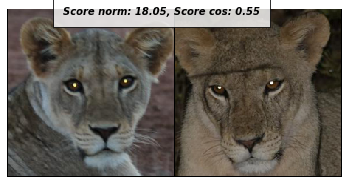

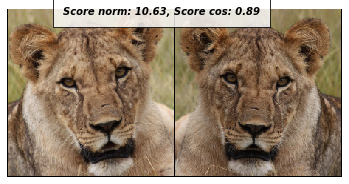

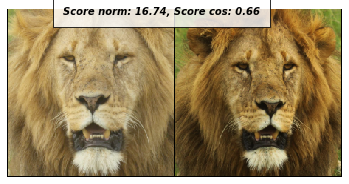

...

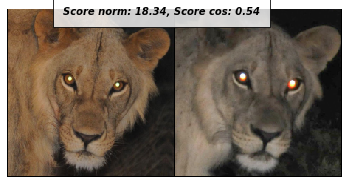

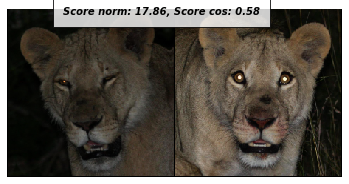

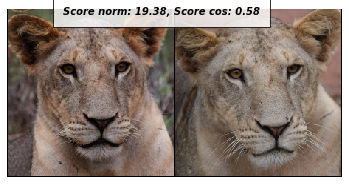

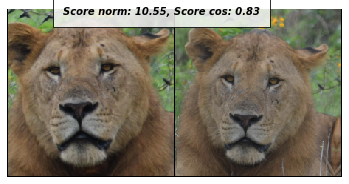

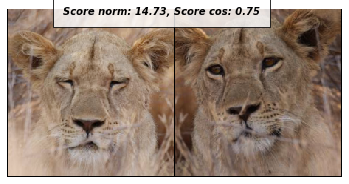

DIFF


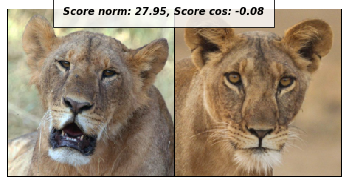

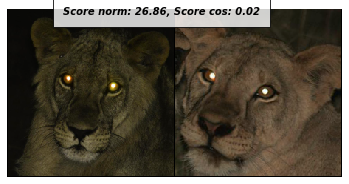

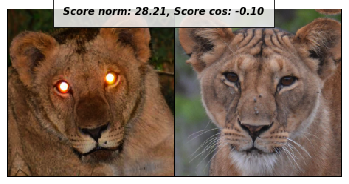

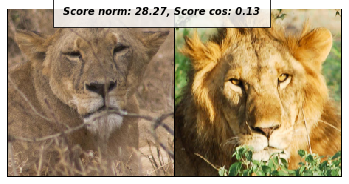

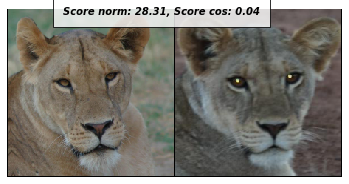

...

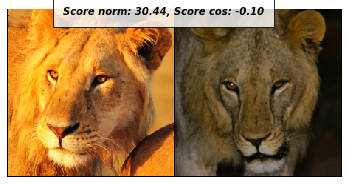

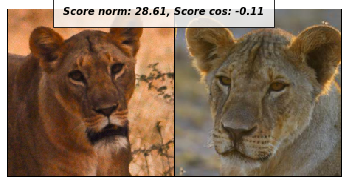

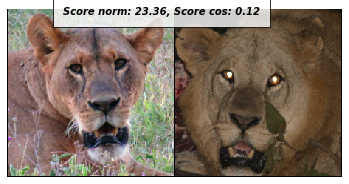

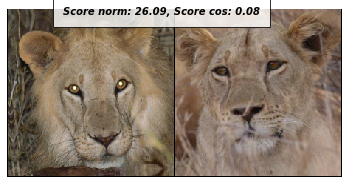

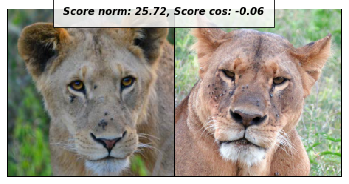

In [14]:
dataset_root = Path("/home/mauto/data/LincParse/cv_dataset_frontal_same")
val_root = dataset_root / "not_used"
num = 30

matches = []
for lion_dir in val_root.iterdir():
    lion_imgs = list(lion_dir.iterdir())
    for i, img1 in enumerate(lion_imgs):
        i += 1
        if i < len(lion_imgs):
            for img2 in lion_imgs[i:]:
                matches.append((img1, img2))

miss_matches = set()
images = list(val_root.glob("*/*.jpg"))
while len(miss_matches) < num:
    img1 = random.choice(images)
    img2 = random.choice(images)
    if img1 != img2:
        miss_matches.add((img1, img2))
        
emb_layer = list(learn.model.modules())[-3]
cos = torch.nn.CosineSimilarity()
tfms = get_transforms(max_warp=0)
random.shuffle(matches)
print("SAME")
for pair in matches[:num]:
    print_pair(pair,tfms,learn,cos,emb_layer)

print("DIFF")
for pair in miss_matches:
    print_pair(pair,tfms,learn,cos,emb_layer)


## Get ID scores

In [15]:
not_used = (ImageList.from_folder(dataset_root/'not_used')
    .split_by_folder()          
    .label_from_folder()
    .transform(None, size=224)
    .databunch()
    .normalize(imagenet_stats))

In [16]:
fix_train = not_used.train_dl.new(shuffle=False, drop_last=False)
fix_valid = not_used.valid_dl.new(shuffle=False, drop_last=False)

In [17]:
def get_embeddings(cls, learn, dl_train, dl_valid,**kwargs):
    hook = hook_output(list(learn.model.modules())[-3])

    train_actns = cls.get_actns(learn, hook=hook, dl=dl_train, **kwargs)
    valid_actns = cls.get_actns(learn, hook=hook, dl=dl_valid, **kwargs)

    return train_actns, valid_actns

In [19]:
emb_gal, emb_probes = get_embeddings(DatasetFormatter, learn, fix_train, fix_valid, pool=None)

Getting activations...


Getting activations...


In [20]:
def identification_score(emb_gal, label_gal, emb_probes, label_probes):
    knn_classifier_l2 = KNeighborsClassifier(n_neighbors=5, n_jobs=-1)
    knn_classifier_cosine = KNeighborsClassifier(n_neighbors=5, metric=cosine, n_jobs=-1)

    knn_classifier_l2.fit(emb_gal, label_gal)
    knn_classifier_cosine.fit(emb_gal, label_gal)

    top1_acc_l2 = knn_classifier_l2.score(emb_probes, label_probes)
    top1_acc_cos = knn_classifier_cosine.score(emb_probes, label_probes)

    l2_neighbors = knn_classifier_l2.kneighbors(emb_probes, n_neighbors=5, return_distance=False)
    cos_neighbors = knn_classifier_cosine.kneighbors(
        emb_probes, n_neighbors=5, return_distance=False
    )

    top5_acc_l2 = 0
    top5_acc_cos = 0

    for i in range(len(l2_neighbors)):
        top5_acc_l2 += 1 if label_probes[i] in label_gal[l2_neighbors[i]] else 0
        top5_acc_cos += 1 if label_probes[i] in label_gal[cos_neighbors[i]] else 0

    top5_acc_l2 = top5_acc_l2 / len(l2_neighbors)
    top5_acc_cos = top5_acc_cos / len(l2_neighbors)

    return top1_acc_l2, top5_acc_l2, top1_acc_cos, top5_acc_cos

In [21]:
identification_score(emb_gal, not_used.train_ds.y.items, emb_probes, not_used.valid_ds.y.items)

(0.5670731707317073,
 0.8780487804878049,
 0.5609756097560976,
 0.8780487804878049)

## Plot most similar images

In [22]:
def plot_most_similar(img_probes, emb_probes, label_probes, img_gal, emb_gal, label_gal, k):
    knn_classifier_l2 = KNeighborsClassifier(n_neighbors=5, n_jobs=-1)
    knn_classifier_cosine = KNeighborsClassifier(n_neighbors=5, metric=cosine, n_jobs=-1)

    knn_classifier_l2.fit(emb_gal, label_gal)
    knn_classifier_cosine.fit(emb_gal, label_gal)

    l2_neighbors = knn_classifier_l2.kneighbors(emb_probes, n_neighbors=k, return_distance=False)
    cos_neighbors = knn_classifier_cosine.kneighbors(
        emb_probes, n_neighbors=k, return_distance=False
    )

    for i,img_probe in enumerate(img_probes):
        fig, ax = plt.subplots(ncols=k + 1, figsize=[15, (k + 1) * 15])
        ax[0].imshow(transforms.ToPILImage()(img_probe.data))
        ax[0].title.set_text('Original - {}'.format(label_probes[i]))
        for j, img in enumerate(img_gal[l2_neighbors[i]]):
            ax[j + 1].imshow(transforms.ToPILImage()(img.data))
            if label_probes[i] == label_gal[l2_neighbors[i]][j]:
                ax[j + 1].title.set_text('Correct - {}'.format(label_gal[l2_neighbors[i]][j]))
            else:
                ax[j + 1].title.set_text('Wrong - {}'.format(label_gal[l2_neighbors[i]][j]))
        plt.tight_layout()
        plt.show()
        plt.close(fig)

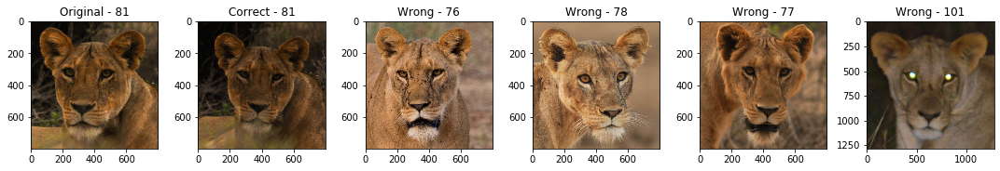

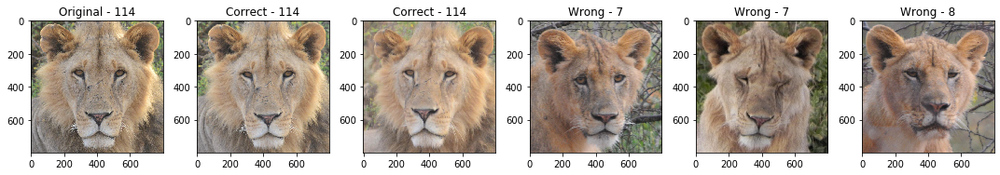

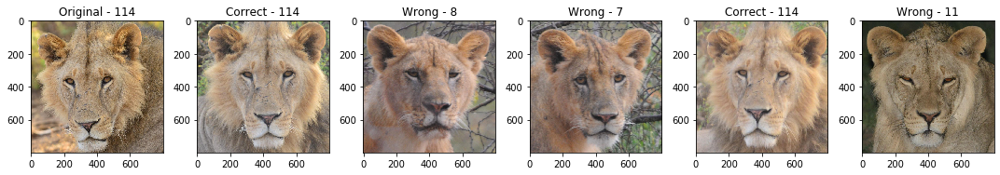

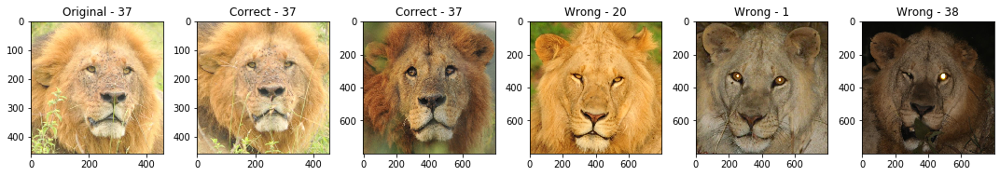

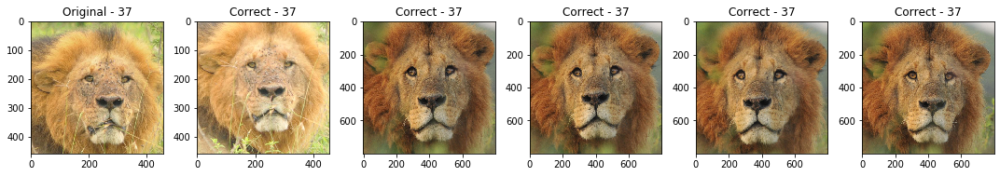

...

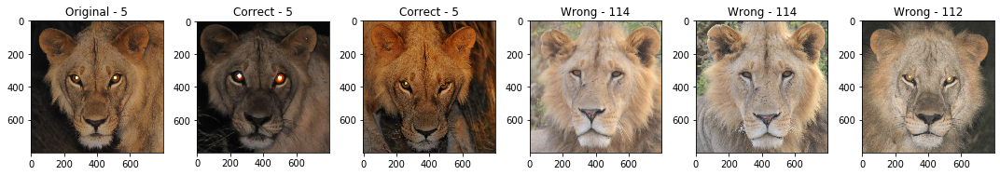

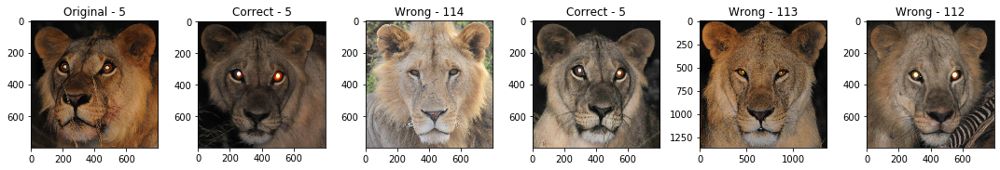

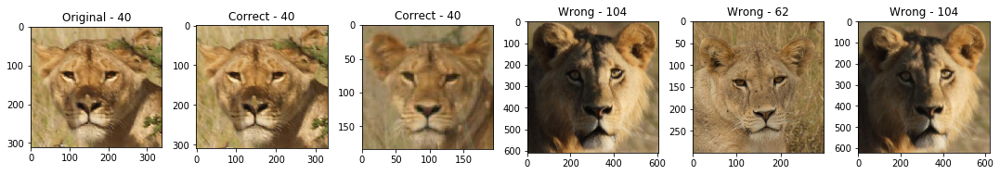

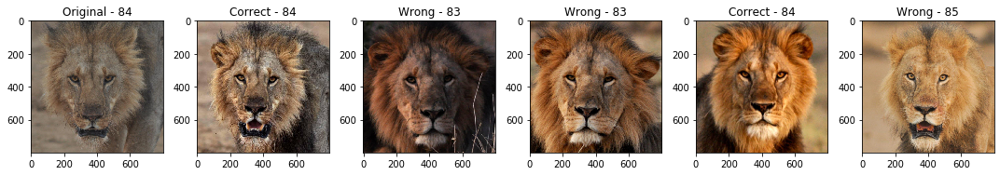

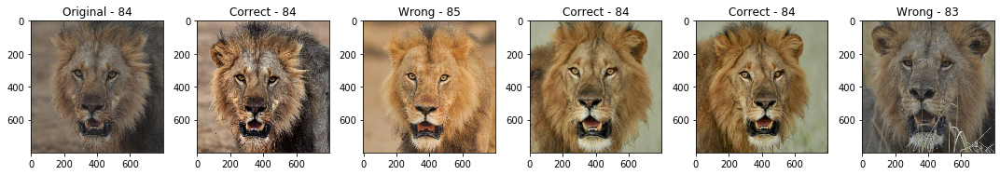

KeyboardInterrupt: 

In [23]:
plot_most_similar(not_used.valid_ds.x, emb_probes, not_used.valid_ds.y.items, not_used.train_ds.x, emb_gal, not_used.train_ds.y.items, 5)
